# InPatient Data

In [290]:
import pandas as pd
import numpy as np

benefit = pd.read_csv("/home/ikenna/Downloads/Train_Beneficiarydata-1542865627584.csv")

inpatient = pd.read_csv("/home/ikenna/Downloads/Train_Inpatientdata-1542865627584.csv")

result = pd.read_csv("/home/ikenna/Downloads/Train-1542865627584.csv")

print(len(benefit))
print(len(inpatient))
print(len(result))

benefit.head()

138556
40474
5410


,BeneID,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,...,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,1943-01-01,NaN,1,1,0,39,230,12,12,...,1,1,1,2,1,1,36000,3204,60,70
1,BENE11002,1936-09-01,NaN,2,1,0,39,280,12,12,...,2,2,2,2,2,2,0,0,30,50
2,BENE11003,1936-08-01,NaN,1,1,0,52,590,12,12,...,2,2,1,2,2,2,0,0,90,40
3,BENE11004,1922-07-01,NaN,1,1,0,39,270,12,12,...,2,1,1,1,1,2,0,0,1810,760
4,BENE11005,1935-09-01,NaN,1,1,0,24,680,12,12,...,2,1,2,2,2,2,0,0,1790,1200


In [291]:
inpatient.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,2724,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,NaN,NaN,NaN,NaN,7092.0,NaN,NaN,NaN,NaN,NaN
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,BENE11011,CLM38412,2009-02-14,2009-02-22,PRV52405,5000,PHY369659,PHY392961,PHY349768,2009-02-14,...,25062,40390,4019,NaN,331.0,NaN,NaN,NaN,NaN,NaN
4,BENE11014,CLM63689,2009-08-13,2009-08-30,PRV56614,10000,PHY379376,PHY398258,NaN,2009-08-13,...,5119,29620,20300,NaN,3893.0,NaN,NaN,NaN,NaN,NaN


In [292]:
result.head()

,Provider,PotentialFraud
0,PRV51001,No
1,PRV51003,Yes
2,PRV51004,No
3,PRV51005,Yes
4,PRV51007,No


In [293]:
benefit.dtypes

BeneID                             object
DOB                                object
DOD                                object
Gender                              int64
Race                                int64
RenalDiseaseIndicator              object
State                               int64
County                              int64
NoOfMonths_PartACov                 int64
NoOfMonths_PartBCov                 int64
ChronicCond_Alzheimer               int64
ChronicCond_Heartfailure            int64
ChronicCond_KidneyDisease           int64
ChronicCond_Cancer                  int64
ChronicCond_ObstrPulmonary          int64
ChronicCond_Depression              int64
ChronicCond_Diabetes                int64
ChronicCond_IschemicHeart           int64
ChronicCond_Osteoporasis            int64
ChronicCond_rheumatoidarthritis     int64
ChronicCond_stroke                  int64
IPAnnualReimbursementAmt            int64
IPAnnualDeductibleAmt               int64
OPAnnualReimbursementAmt          

In [294]:
result_inpatient = pd.merge(inpatient, result, how='inner', on=['Provider'])
result_inpatient.head()

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,PotentialFraud
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Yes
1,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,2753,E9305,NaN,7769.0,5849.0,NaN,NaN,NaN,NaN,Yes
2,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,43812,4019,NaN,9338.0,NaN,NaN,NaN,NaN,NaN,Yes
3,BENE22934,CLM73394,2009-10-25,2009-10-29,PRV55912,13000,PHY390614,PHY323689,PHY363291,2009-10-25,...,NaN,NaN,NaN,8154.0,NaN,NaN,NaN,NaN,NaN,Yes
4,BENE24402,CLM32911,2009-01-08,2009-01-12,PRV55912,3000,PHY380413,PHY432598,NaN,2009-01-08,...,NaN,NaN,NaN,8543.0,NaN,NaN,NaN,NaN,NaN,Yes


In [295]:
result_inpatient_benefit = pd.merge(result_inpatient,benefit, how='inner', on=['BeneID'])
print(len(result_inpatient_benefit))
print(result_inpatient_benefit.dtypes)
result_inpatient_benefit.head()

40474
BeneID                              object
ClaimID                             object
ClaimStartDt                        object
ClaimEndDt                          object
Provider                            object
InscClaimAmtReimbursed               int64
AttendingPhysician                  object
OperatingPhysician                  object
OtherPhysician                      object
AdmissionDt                         object
ClmAdmitDiagnosisCode               object
DeductibleAmtPaid                  float64
DischargeDt                         object
DiagnosisGroupCode                  object
ClmDiagnosisCode_1                  object
ClmDiagnosisCode_2                  object
ClmDiagnosisCode_3                  object
ClmDiagnosisCode_4                  object
ClmDiagnosisCode_5                  object
ClmDiagnosisCode_6                  object
ClmDiagnosisCode_7                  object
ClmDiagnosisCode_8                  object
ClmDiagnosisCode_9                  object
ClmDi

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,1,1,1,2,1,1,36000,3204,60,70
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,1,1,1,2,1,1,36000,3204,60,70
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,1,1,1,2,1,1,36000,3204,60,70
3,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,2,2,1,2,2,2,19000,1068,100,20
4,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,2,2,1,1,2,2,17000,1068,1050,540


In [296]:
result_inpatient_benefit.describe

<bound method NDFrame.describe of            BeneID   ClaimID ClaimStartDt  ClaimEndDt  Provider  \
0       BENE11001  CLM46614   2009-04-12  2009-04-18  PRV55912   
1       BENE11001  CLM66048   2009-08-31  2009-09-02  PRV55907   
2       BENE11001  CLM68358   2009-09-17  2009-09-20  PRV56046   
3       BENE17521  CLM34721   2009-01-20  2009-02-01  PRV55912   
4       BENE21718  CLM72336   2009-10-17  2009-11-04  PRV55912   
5       BENE22934  CLM73394   2009-10-25  2009-10-29  PRV55912   
6       BENE22934  CLM68299   2009-09-16  2009-09-19  PRV55978   
7       BENE24402  CLM32911   2009-01-08  2009-01-12  PRV55912   
8       BENE28966  CLM56700   2009-06-22  2009-06-25  PRV55912   
9       BENE29251  CLM42062   2009-03-11  2009-03-19  PRV55912   
10      BENE31905  CLM37729   2009-02-10  2009-03-03  PRV55912   
11      BENE31905  CLM49964   2009-05-06  2009-05-09  PRV55912   
12      BENE31905  CLM77968   2009-12-01  2009-12-05  PRV55912   
13      BENE31905  CLM80697   2009-12-25  

In [297]:
result_inpatient_benefit.RenalDiseaseIndicator  # There are 0 and Y ) for No and Y for yes

0        0
1        0
2        0
3        0
4        0
5        0
6        0
7        0
8        0
9        Y
10       Y
11       Y
12       Y
13       Y
14       Y
15       Y
16       Y
17       Y
18       Y
19       0
20       0
21       0
22       0
23       0
24       0
25       Y
26       Y
27       Y
28       Y
29       0
30       0
31       0
32       Y
33       Y
34       Y
35       0
36       0
37       0
38       0
39       0
40       Y
41       Y
42       0
43       0
44       0
45       0
46       Y
47       Y
48       0
49       0
50       0
51       0
52       0
53       0
54       0
55       0
56       0
57       0
58       0
59       Y
60       0
61       0
62       Y
63       Y
64       Y
65       Y
66       Y
67       0
68       0
69       Y
70       Y
71       0
72       0
73       0
74       0
75       0
76       Y
77       0
78       0
79       0
80       0
81       0
82       Y
83       0
84       0
85       0
86       Y
87       0
88       0
89       0
90       Y

In [298]:
result_inpatient_benefit['ClmProcedureCode_1']
#change 2s to 0s for Nos in all data column
result_inpatient_benefit = result_inpatient_benefit.replace({'ChronicCond_Alzheimer': 2, 'ChronicCond_Heartfailure': 2, 'ChronicCond_KidneyDisease': 2,
                           'ChronicCond_Cancer': 2, 'ChronicCond_ObstrPulmonary': 2, 'ChronicCond_Depression': 2, 
                           'ChronicCond_Diabetes': 2, 'ChronicCond_IschemicHeart': 2, 'ChronicCond_Osteoporasis': 2, 
                           'ChronicCond_rheumatoidarthritis': 2, 'ChronicCond_stroke': 2 }, 0)

result_inpatient_benefit = result_inpatient_benefit.replace({'RenalDiseaseIndicator': 'Y'}, 1)


In [299]:
print(len(benefit))
benefit.isna().sum()  
# There are 137135 out of 138556 beneficiary in general that are still alive.

138556


BeneID                                  0
DOB                                     0
DOD                                137135
Gender                                  0
Race                                    0
RenalDiseaseIndicator                   0
State                                   0
County                                  0
NoOfMonths_PartACov                     0
NoOfMonths_PartBCov                     0
ChronicCond_Alzheimer                   0
ChronicCond_Heartfailure                0
ChronicCond_KidneyDisease               0
ChronicCond_Cancer                      0
ChronicCond_ObstrPulmonary              0
ChronicCond_Depression                  0
ChronicCond_Diabetes                    0
ChronicCond_IschemicHeart               0
ChronicCond_Osteoporasis                0
ChronicCond_rheumatoidarthritis         0
ChronicCond_stroke                      0
IPAnnualReimbursementAmt                0
IPAnnualDeductibleAmt                   0
OPAnnualReimbursementAmt          

In [300]:
print(len(result_inpatient_benefit))
result_inpatient_benefit.isna().sum()
# There are 40156 out of 40474 beneficiary that are inpatient that are still alive.

40474


BeneID                                 0
ClaimID                                0
ClaimStartDt                           0
ClaimEndDt                             0
Provider                               0
InscClaimAmtReimbursed                 0
AttendingPhysician                   112
OperatingPhysician                 16644
OtherPhysician                     35784
AdmissionDt                            0
ClmAdmitDiagnosisCode                  0
DeductibleAmtPaid                    899
DischargeDt                            0
DiagnosisGroupCode                     0
ClmDiagnosisCode_1                     0
ClmDiagnosisCode_2                   226
ClmDiagnosisCode_3                   676
ClmDiagnosisCode_4                  1534
ClmDiagnosisCode_5                  2894
ClmDiagnosisCode_6                  4838
ClmDiagnosisCode_7                  7258
ClmDiagnosisCode_8                  9942
ClmDiagnosisCode_9                 13497
ClmDiagnosisCode_10                36547
ClmProcedureCode

In [301]:
# Create an Age column ------This is could be a featyre engineering
result_inpatient_benefit['DOB'] = pd.to_datetime(result_inpatient_benefit['DOB'] , format = '%Y-%m-%d')
result_inpatient_benefit['DOD'] = pd.to_datetime(result_inpatient_benefit['DOD'],format = '%Y-%m-%d',errors='ignore')
result_inpatient_benefit['Age'] = round(((result_inpatient_benefit['DOD'] - result_inpatient_benefit['DOB']).dt.days)/365)

In [302]:
print(benefit['DOD'].head(20)) 
#This is possibly data set from 2009 and last entry seems to be 2009-12-01 so we would use the 
#end of yeah 2009-12-31 as the last date of this dataset and then substitute that for the end dats of all others 
result_inpatient_benefit.Age.fillna(round(((pd.to_datetime('2009-12-31' , format = '%Y-%m-%d') - result_inpatient_benefit['DOB']).dt.days)/365),inplace=True)
result_inpatient_benefit.head()

0            NaN
1            NaN
2            NaN
3            NaN
4            NaN
5            NaN
6     2009-12-01
7            NaN
8            NaN
9            NaN
10           NaN
11           NaN
12           NaN
13           NaN
14           NaN
15           NaN
16           NaN
17           NaN
18           NaN
19           NaN
Name: DOD, dtype: object


,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,1,1,0,1,1,36000,3204,60,70,67.0
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,1,1,0,1,1,36000,3204,60,70,67.0
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,1,1,0,1,1,36000,3204,60,70,67.0
3,BENE17521,CLM34721,2009-01-20,2009-02-01,PRV55912,19000,PHY349293,PHY370861,PHY363291,2009-01-20,...,0,1,0,0,0,19000,1068,100,20,96.0
4,BENE21718,CLM72336,2009-10-17,2009-11-04,PRV55912,17000,PHY334706,PHY334706,NaN,2009-10-17,...,0,1,1,0,0,17000,1068,1050,540,87.0


In [304]:
# Next is to add if beneficiary is dead or alive. Alive column where DOD == NaT then alive for 1 and a 0 for no if there is a DOD present.
result_inpatient_benefit.loc[result_inpatient_benefit['DOD'].isna(),'Alive']=1
result_inpatient_benefit.loc[result_inpatient_benefit['DOD'].notna(),'Alive']=0

In [305]:
# Next we focus on number of physicians an inpatient beneficiary saw on a particular visit
# From the three physicians types we can filter through NAs and assign 0 through 3 to a column NoPhysician
stat = []
for index, row in result_inpatient_benefit.iterrows():
    if (pd.notnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.notnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(2)
    elif (pd.notnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(3)
    elif (pd.isnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.isnull(row['AttendingPhysician']) and pd.notnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(2)
    elif (pd.isnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(1)
    elif (pd.isnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.isnull(row['OperatingPhysician'])):
        stat.append(0)
    elif (pd.notnull(row['AttendingPhysician']) and pd.isnull(row['OtherPhysician']) and pd.notnull(row['OperatingPhysician'])):
        stat.append(2)
    #else: stat.append(700)

In [306]:
stat = np.asarray(stat)
result_inpatient_benefit['NoPhysician'] = stat
test = result_inpatient_benefit[['AttendingPhysician','OtherPhysician','OperatingPhysician','NoPhysician']]
test.head()

,AttendingPhysician,OtherPhysician,OperatingPhysician,NoPhysician
0,PHY390922,NaN,NaN,1
1,PHY318495,NaN,PHY318495,2
2,PHY372395,PHY324689,NaN,2
3,PHY349293,PHY363291,PHY370861,3
4,PHY334706,NaN,PHY334706,2


In [307]:
# Next we focus on having a column with No. of Diagnostics and No. of Proceedures per beneficiary
# column name would be NoOfDiag and NoOfProc respectively.
m = []
for index, row in result_inpatient_benefit.iterrows():
    if (pd.notnull(row['ClmDiagnosisCode_10'])):
        m.append(10)
    elif (pd.notnull(row['ClmDiagnosisCode_9'])):
        m.append(9)
    elif (pd.notnull(row['ClmDiagnosisCode_8'])):
        m.append(8)
    elif (pd.notnull(row['ClmDiagnosisCode_7'])):
        m.append(7)
    elif (pd.notnull(row['ClmDiagnosisCode_6'])):
        m.append(6)
    elif (pd.notnull(row['ClmDiagnosisCode_5'])):
        m.append(5)
    elif (pd.notnull(row['ClmDiagnosisCode_4'])):
        m.append(4)
    elif (pd.notnull(row['ClmDiagnosisCode_3'])):
        m.append(3)
    elif (pd.notnull(row['ClmDiagnosisCode_2'])):
        m.append(2)
    elif (pd.notnull(row['ClmDiagnosisCode_1'])):
        m.append(1)
    

In [308]:
m = np.asarray(m)
result_inpatient_benefit['NoOfDiag'] = m
test = result_inpatient_benefit[['ClmDiagnosisCode_1', 'ClmDiagnosisCode_2',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmDiagnosisCode_10','NoOfDiag']]
test.head()

,ClmDiagnosisCode_1,ClmDiagnosisCode_2,ClmDiagnosisCode_3,ClmDiagnosisCode_4,ClmDiagnosisCode_5,ClmDiagnosisCode_6,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,NoOfDiag
0,1970,4019,5853,7843,2768,71590,2724,19889,5849,NaN,9
1,6186,2948,56400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
2,29623,30390,71690,34590,V1581,32723,NaN,NaN,NaN,NaN,6
3,4240,2639,2948,40390,45821,28489,5854,2753,E9305,NaN,9
4,V5789,4168,73313,7812,7993,78830,72273,43812,4019,NaN,9


In [309]:
#result_inpatient_benefit.isna().sum()
result_inpatient_benefit['Race'].describe()
stat = []
for index, row in result_inpatient_benefit.iterrows():
    list = [row['ClmProcedureCode_1'],row['ClmProcedureCode_2'],row['ClmProcedureCode_3'],row['ClmProcedureCode_4'],row['ClmProcedureCode_5'],row['ClmProcedureCode_6']]
    count = []
    for i in list:
        if pd.notnull(i):
            count.append(i)
    stat.append(len(count)) 

In [310]:
stat = np.asarray(stat)
result_inpatient_benefit['NoOfProc'] = stat
test = result_inpatient_benefit[['ClmProcedureCode_1','ClmProcedureCode_2','ClmProcedureCode_3','ClmProcedureCode_4','ClmProcedureCode_5','ClmProcedureCode_6','NoOfProc']]
test.head()

,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,NoOfProc
0,NaN,NaN,NaN,NaN,NaN,NaN,0
1,7092.0,NaN,NaN,NaN,NaN,NaN,1
2,NaN,NaN,NaN,NaN,NaN,NaN,0
3,7769.0,5849.0,NaN,NaN,NaN,NaN,2
4,9338.0,NaN,NaN,NaN,NaN,NaN,1


In [311]:
# Next we consider adding no of days admitted by subtracting admission date from discharge date.
# if patient were amitted and discharged same day then we have to add 1 because we do not want to have a 0 days.
# Column name ill be DaysAmitted.
result_inpatient_benefit['AdmissionDt'] = pd.to_datetime(result_inpatient_benefit['AdmissionDt'] , format = '%Y-%m-%d')
result_inpatient_benefit['DischargeDt'] = pd.to_datetime(result_inpatient_benefit['DischargeDt'],format = '%Y-%m-%d')
result_inpatient_benefit['DaysAdmitted'] = ((result_inpatient_benefit['DischargeDt'] - result_inpatient_benefit['AdmissionDt']).dt.days) + 1 

In [312]:
# See which percentage is null
pd.set_option('display.max_rows', None)
print(result_inpatient_benefit.isnull().sum()*100/len(result_inpatient_benefit))

BeneID                               0.000000
ClaimID                              0.000000
ClaimStartDt                         0.000000
ClaimEndDt                           0.000000
Provider                             0.000000
InscClaimAmtReimbursed               0.000000
AttendingPhysician                   0.276721
OperatingPhysician                  41.122696
OtherPhysician                      88.412314
AdmissionDt                          0.000000
ClmAdmitDiagnosisCode                0.000000
DeductibleAmtPaid                    2.221179
DischargeDt                          0.000000
DiagnosisGroupCode                   0.000000
ClmDiagnosisCode_1                   0.000000
ClmDiagnosisCode_2                   0.558383
ClmDiagnosisCode_3                   1.670208
ClmDiagnosisCode_4                   3.790087
ClmDiagnosisCode_5                   7.150269
ClmDiagnosisCode_6                  11.953353
ClmDiagnosisCode_7                  17.932500
ClmDiagnosisCode_8                

In [313]:
pd.set_option('display.max_rows', None)
result_inpatient_benefit.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 40474 entries, 0 to 40473
Data columns (total 61 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   BeneID                           40474 non-null  object        
 1   ClaimID                          40474 non-null  object        
 2   ClaimStartDt                     40474 non-null  object        
 3   ClaimEndDt                       40474 non-null  object        
 4   Provider                         40474 non-null  object        
 5   InscClaimAmtReimbursed           40474 non-null  int64         
 6   AttendingPhysician               40362 non-null  object        
 7   OperatingPhysician               23830 non-null  object        
 8   OtherPhysician                   4690 non-null   object        
 9   AdmissionDt                      40474 non-null  datetime64[ns]
 10  ClmAdmitDiagnosisCode            40474 non-null  object   

In [314]:
plot = result_inpatient_benefit[['ClmProcedureCode_1','ClmProcedureCode_2','ClmProcedureCode_3','ClmProcedureCode_4','ClmProcedureCode_5','ClmProcedureCode_6','NoOfProc','ClmDiagnosisCode_1', 'ClmDiagnosisCode_2',
       'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5',
       'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8',
       'ClmDiagnosisCode_9', 'ClmDiagnosisCode_10','NoOfDiag','DaysAdmitted','Alive','Age','Gender','Race','PotentialFraud']]


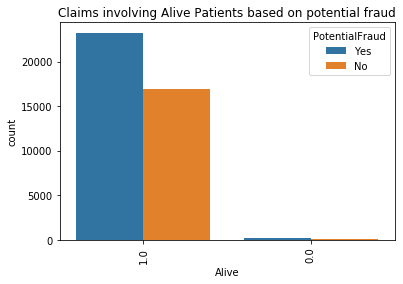

<Figure size 432x288 with 0 Axes>

In [315]:
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

sns.set
#sns.pairplot(plot, hue='PotentialFraud', height=2)
ax= sns.countplot(x='Alive',hue='PotentialFraud',data=plot
              ,order=plot.Alive.value_counts().iloc[:20].index)

    
plt.title('Claims involving Alive Patients based on potential fraud')
plt.xticks(rotation=90)
plt.show()

plt.savefig('TopAttendingphysiciansinvlovedinHealthcareFraud')


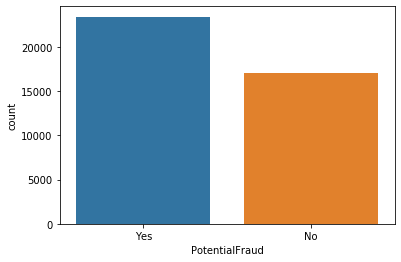

In [316]:
ax= sns.countplot(x='PotentialFraud', data = plot)

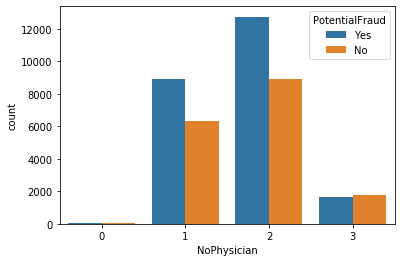

In [322]:
ax= sns.countplot(x='NoPhysician',hue='PotentialFraud', data = result_inpatient_benefit)